# First Individual Project Assignment

## Student Name: Nuwasiima Doreck

## Registration Number: 2022/HD07/1970U


You are a lead data scientist on a project regarding maternal health, you are provided with a dataset regarding featal health. (Please find the dataset in the data folder given). These are your instructions
1 - Use that dataset to do: EDA, Clean the data
2 - Use Pandas Profiling to export a pdf report of your data (explain how the report informs your future decisions)
3 - Apply any needed transformations if possible.
4 - Choose a proper evaluation metric for your project.
5 - Do model spot checking to find the best model for your use.
6 - Build the chosen model
7 - Evaluate bias vs variance on your model and present your results.

Note:

- Please follow instructions!
- You have to explain in detail every step you are executing in your own words, your result will be based on how well you explain what steps you are executing.
- Students are allowed to use public resources off the internet for their research, however students are not allowed to copy and paste code for this assignment (If you are caught, you will fail this assignment, you have been warned: especially chatGpt.)
- This is a graded individual assignment any malpractice will lead to losing of points, this assignment contributes a great percentage to your final grade.
- All assignments must be handed in by Close of Business next Wednesday by 6:00PM Date: 3rd - May - 2023
- All your assignments will be handed in by means of a pull request to my original repository.
- Please name your pull requests as per previously instructed, you will not get warnings for failing to do this.
- Your work should be saved in the Project Folder (Create your own folder and give the folder your name.)


## Importing the relevant libraries and removing warnings.
We will first import the necessary libraries for the project, and remove the warnings.

In [27]:
# Importing Libraries
import numpy as np
import pandas as pd
from ydata_profiling import ProfileReport

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score
from sklearn import metrics
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.neural_network import MLPClassifier

import warnings
warnings.filterwarnings('ignore')

## Load the data
Next, we load the fetal_health dataset and quickly scan through the first and last 5 rows. 

In [28]:
fetal_data = pd.read_csv('fetal_health.csv')
fetal_data

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.000,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.000,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.000,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.0,0.000,0.000,0.007,0.000,0.0,0.0,79.0,0.2,25.0,...,137.0,177.0,4.0,0.0,153.0,150.0,152.0,2.0,0.0,2.0
2122,140.0,0.001,0.000,0.007,0.000,0.0,0.0,78.0,0.4,22.0,...,103.0,169.0,6.0,0.0,152.0,148.0,151.0,3.0,1.0,2.0
2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,79.0,0.4,20.0,...,103.0,170.0,5.0,0.0,153.0,148.0,152.0,4.0,1.0,2.0
2124,140.0,0.001,0.000,0.006,0.000,0.0,0.0,78.0,0.4,27.0,...,103.0,169.0,6.0,0.0,152.0,147.0,151.0,4.0,1.0,2.0


We will also use **fetal_data.describe().T** function to further analyse our data. This computes descriptive statistics for numerical columns. It produces various statistics such as count, mean, standard deviation, minimum value, quartiles, and maximum value. These statistics provide an overview of the central tendency, spread, and distribution shape of the numeric data as shown below:

In [29]:
fetal_data.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


From this initial scan of our data, it is clear that this data has 2126 rows and 22 columns. The different variables have been noted. From my experience in Nursing (my first degree), I can tell that this is cardiotocograph (CTG) data. CTG, also called electronic fetal monitoring (EFM) is the most widely used technique for assessing fetal wellbeing during labour in the developed world. The major purpose of CTG is to monitor the fetus and prevent harmful fetal and maternal outcomes. 

There are no missing values and there seems to be few outliers according to the quartiles above.

We will then check for missing values using **fetal_data.info()** and  **fetal_data.isna().sum().sum()**.Both commands show that there are no missing values as shown below. According to the **fetal_data.info()** summary below, we surmise that the data is only composed of floats; no categorical or string data reported.

In [30]:
fetal_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In [31]:
fetal_data.isna().sum().sum()

0

## Exploratory Data Analysis (EDA)
We will first create a copy of the data frame that we have named "eda_df" which we will use to generate an exploratory data report to further analyse our data. The reason for copying the dataframe is to maintain the original dataframe in the same condition in case we need to use it again. 

In [32]:
eda_df = fetal_data.copy()
eda_df


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.000,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.000,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.000,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.000,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.0,0.000,0.000,0.007,0.000,0.0,0.0,79.0,0.2,25.0,...,137.0,177.0,4.0,0.0,153.0,150.0,152.0,2.0,0.0,2.0
2122,140.0,0.001,0.000,0.007,0.000,0.0,0.0,78.0,0.4,22.0,...,103.0,169.0,6.0,0.0,152.0,148.0,151.0,3.0,1.0,2.0
2123,140.0,0.001,0.000,0.007,0.000,0.0,0.0,79.0,0.4,20.0,...,103.0,170.0,5.0,0.0,153.0,148.0,152.0,4.0,1.0,2.0
2124,140.0,0.001,0.000,0.006,0.000,0.0,0.0,78.0,0.4,27.0,...,103.0,169.0,6.0,0.0,152.0,147.0,151.0,4.0,1.0,2.0


### Counting duplicate rows
We will count the duplicate rows if any using **eda_df.duplicated().sum()**. For a more detailed rport, we will also generate a Pandas Profiling Report.

In [33]:
# Counting duplicate rows

num_duplicate_rows = eda_df.duplicated().sum()
print(f"Number of duplicate rows is: {num_duplicate_rows}")

Number of duplicate rows is: 13


In [34]:
from ydata_profiling import ProfileReport

### Profile Report

In [35]:
# Generating a Pandas profiling report

profile = ProfileReport(eda_df, title='Fetal health Profiling Report', html={'style': {'full_width': True}})
profile.to_file('output.html')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

According to the above report, there are 11 duplicate rows, albeit **eda_df.duplicated().sum()** gave us 13 duplicate rows. Nevertheless, we will use the code below to remove duplicate rows and count the number of duplicate rows again to confirm that they have been removed.

In [36]:
# Removing duplicate rows

eda_df.drop_duplicates(inplace=True)
num_duplicate_rows = eda_df.duplicated().sum()
print(f"Number of duplicate rows is: {num_duplicate_rows}")


Number of duplicate rows is: 0


The profile report also indicates that there are 3 categorical values. However, the function **fetal_data.info()** above had reported no categorical values. We note that the categorical values were recorded as numerics.

## Data distribution
We will now generate histogram plots for each column so as to determine the distribution of this data. This will help us to visually determine if there are any outliers to remove or not.

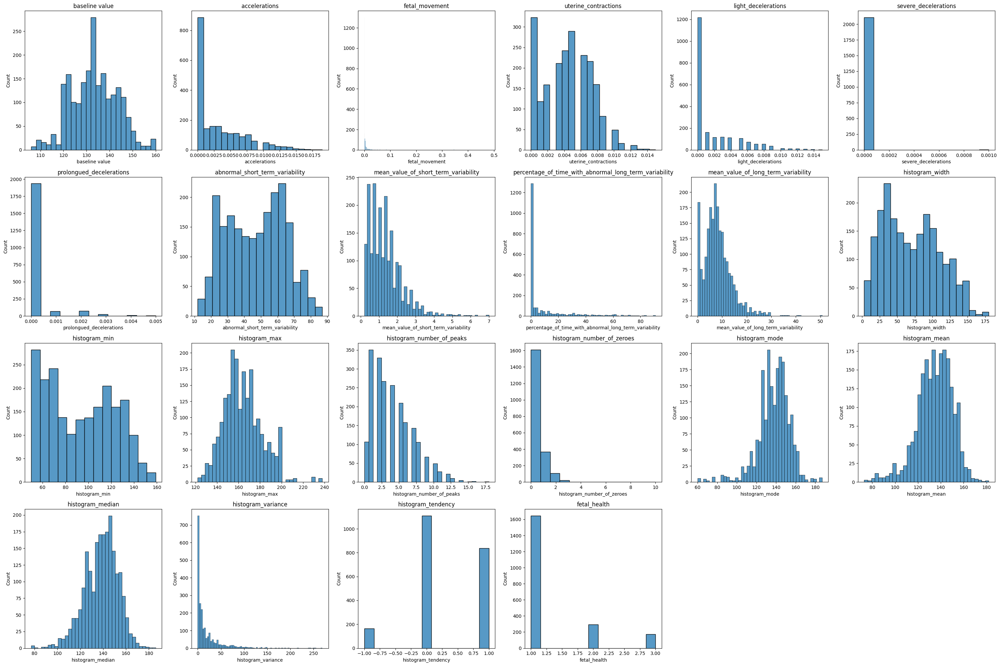

In [51]:
# Generating plots

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

plt.ion()  # Enable interactive mode

plt.figure(figsize=(30, 20))
for i, column in enumerate(eda_df.columns):
    plt.subplot(4, 6, i + 1)
    sns.histplot(data=eda_df[column])
    plt.title(column)

plt.tight_layout()
plt.show()


According to the histograms above, we make the folowing observations:
- Most columns have normally distributed values. 
- There are outliers in our data which we are not sure of their origin; be as errors or as a result of expected CTG values. If we remove them, we might overfit our data and introduce errors in the model. Therefore, we will not remove any outliers.
- The plot for severe decelerations has only 2 values but they do not seem to be categorical data. 
- The plot for fetal_health column clearly shows that it is a categorical variable with 3 categories. 
- Even though the profile reportof data had stated that there are 3 categorical variables, we note that only fetal_health is a categorical variable that was represented in form of numeric values 1.0, 2.0, and 3.0. 
- Fetal_health column represents our output variable.  
- The values are all not in the same scale range. We will show a range plot below to confirm this observation.
## Data range
Here, we examine the range of our data and observe that our data is in different ranges. We will need to scale the data in the same range before designing the model (which we did in the "Pre processing" section ahead).

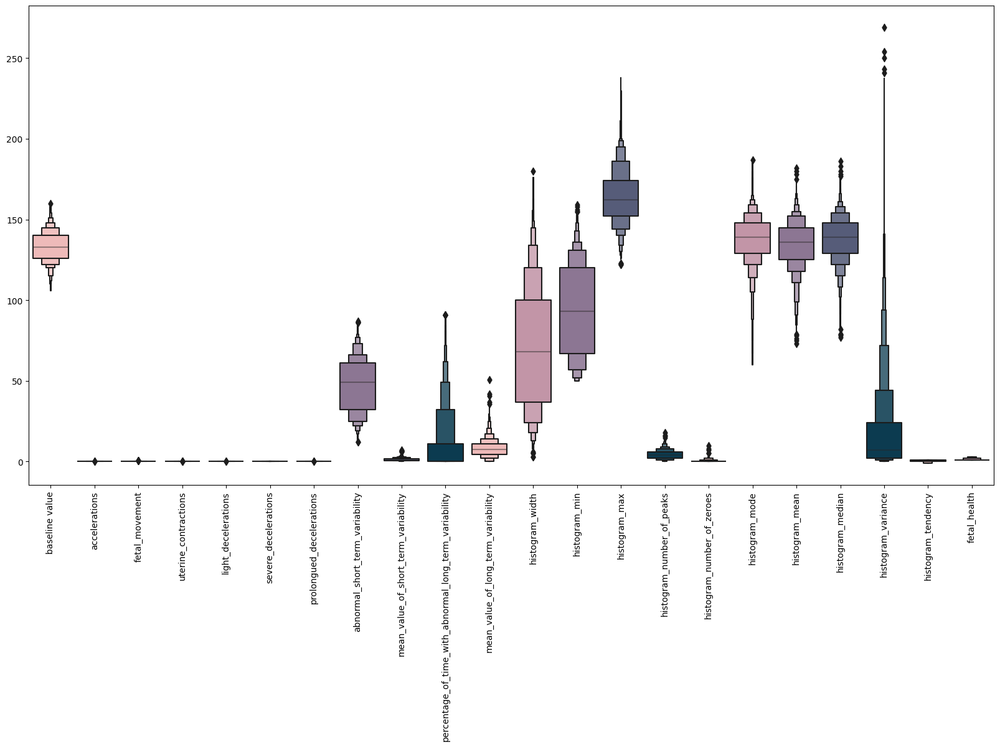

In [52]:
# demonstrating data range
%matplotlib inline
shades =["#f7b2b0","#c98ea6","#8f7198","#50587f", "#003f5c"]
plt.figure(figsize=(20,10))
sns.boxenplot(data = eda_df,palette = shades)
plt.xticks(rotation=90)
plt.show()

## Analysing the output variable (fetal_health)
While trying to understand this data, I found out that the fetal_health column which is our output variable was classified into 3 categories by expert obstetricians as follows:
- Normal
- Suspect
- Pathological

These categories correspond to the values in the data as follows:
- Normal          1.0
- Suspect         2.0
- Pathological    3.0

We will analyse further our output variable and summarise it by generating a piechart showing the different categories.

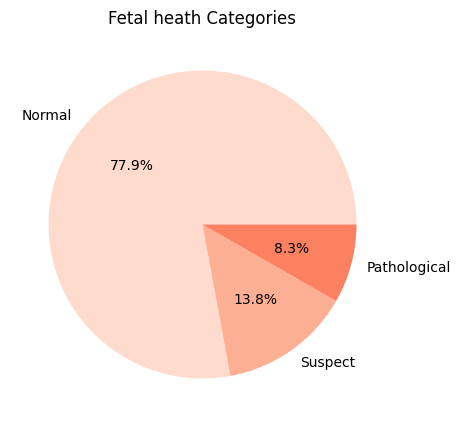

In [53]:
# plotting the output variable
%matplotlib inline
plt.figure(figsize=(5, 5))

plt.pie(
    eda_df['fetal_health'].value_counts(),
    autopct='%.1f%%',
    labels=["Normal", "Suspect", "Pathological"],
    colors=sns.color_palette('Reds')
)
plt.title("Fetal heath Categories")
plt.show()

From the piechart above, we note that 77.8% of the fetuses are normal followed by 13.9% which are suspect and only 8.3% are pathological.

## Correlation with output variable

In this step, we will demonstrate the relationship between input variables,and the output variable "fetal_health." The objective is to gain an initial understanding of the associations between the features. In the resultant heatmap, we will identify the features that exhibit dark colors, indicating a strong correlation with the target variable.

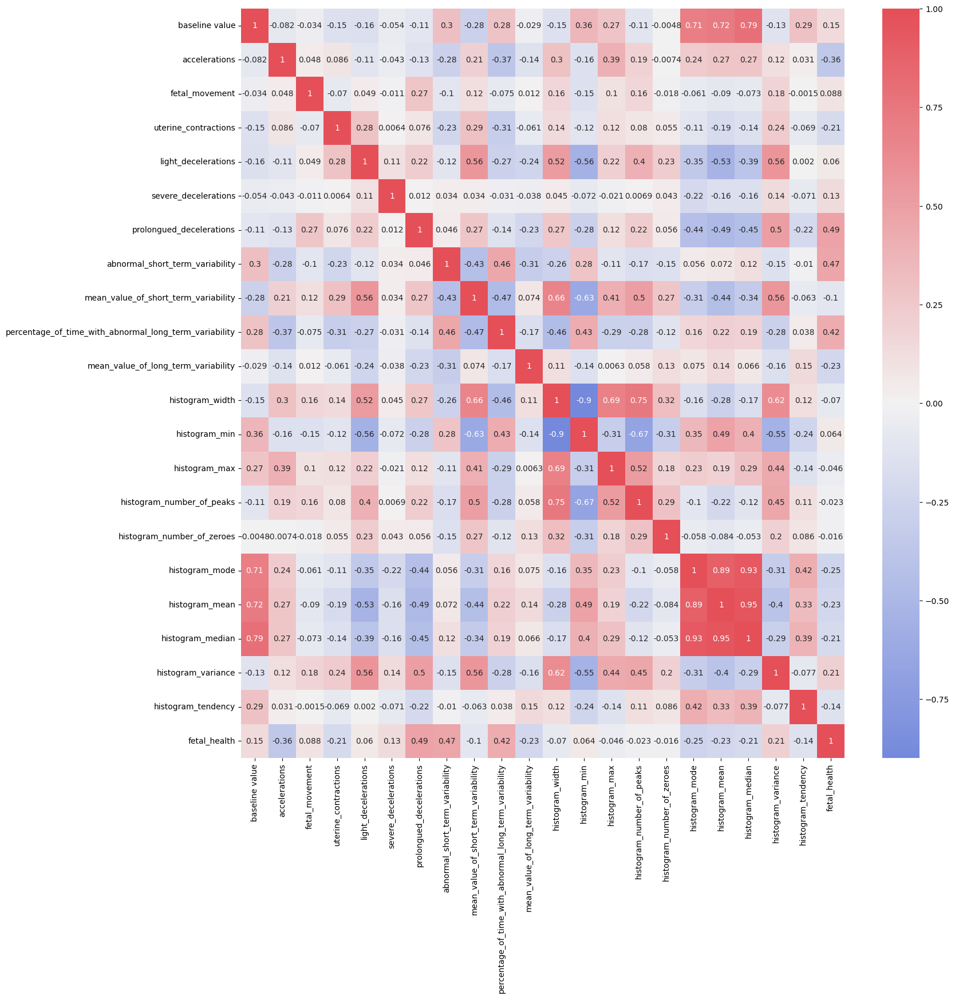

In [54]:
#compute correlation matrix

corr = eda_df.corr()

# create heatmap plot of correlation matrix
%matplotlib inline
plt.figure(figsize=(17,17))  
cmap = sns.diverging_palette(260, 10, s=70, l=55, n=9, as_cmap=True)
sns.heatmap(corr, annot=True, cmap=cmap, center=0)
plt.show()

From the correlation matrix, we note that there is high positive correlation between the histogram_mean, histogram_mode and histogram_median. There is also strong negative correlation between the histogram_width and histogram_min. 
Other meaningful correlations include:
- Prolongued_decelerations and abnormal_short_term_variability which are moderately related with the fetal health well being. From literature, higher values of prolonged decelerations and short term variability indicate fetal distress. 
- Accelerations have a moderately negative correlation value with fetal_health (biologically meaning that the more accelerations are found in normal fetuses in this case denoted the value of 1.0. The more the fetus_health deteriorates (values 2.0 and 3.0), the fewer the accelerations). This is expected biologically.

We will take a closer look at the following relationships which make biological sense (with the baseline value being on the y axis):
- prolongued_decelerations and fetal_health
- abnormal_short_term_variability and fetal_health
- acelerations and fetal_health


**Prolonged_decelerations Vs Fetal Health**

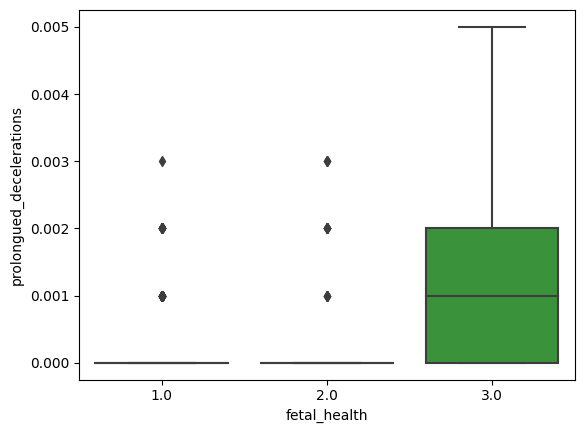

In [55]:
# Boxplot correlations

%matplotlib inline
sns.boxplot(data =eda_df,x="fetal_health", y="prolongued_decelerations")
plt.show()

This plot clearly shows that prolongued_decelerations are strongly correlated with fetal_health with the PATHOLOGICAL category of fetal_health having big numbers of prolonged decelerations.

**Abnormal_short_term_variability Vs Fetal Health**

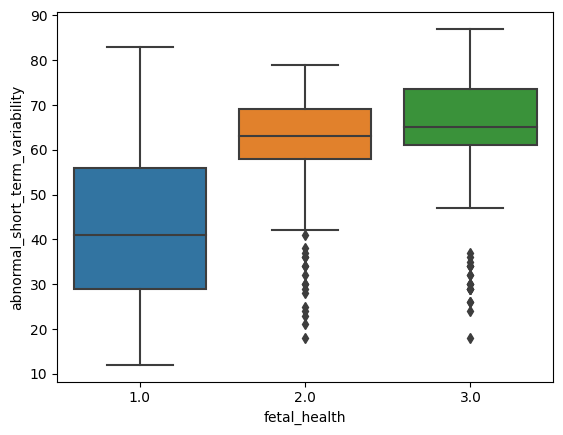

In [56]:
# Boxplot correlations

%matplotlib inline
sns.boxplot(data =eda_df,x="fetal_health", y="abnormal_short_term_variability")
plt.show()

Although there is more coverage of abnormal_short_term_variability among the NORMAL category of fetal_health, we note that higher values of abnormal_short_term_variability are found among the SUSPECT and PATHOLOGICAL categories of fetal_health indicating a positive correlation.

**Accelerations Vs Fetal Health**

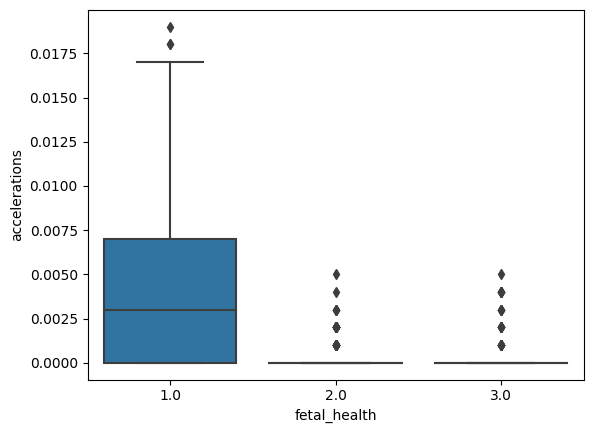

In [57]:
#Boxplot correlations

%matplotlib inline
sns.boxplot(data =eda_df,x="fetal_health", y="accelerations")
plt.show()

More accelerations are found in the NORMAL category of fetal_health. This indicates that more accelerations are protective of the fetus ie, the more accelerations, the more NORMAL the fetus and fewer accelerations lead to deterioration of the fetus.


## Pre processing
In this section, we will now preprocess the data before model building following these steps.
- We will write a function that makes a copy of the original data such that we use that copy and maintain the original dataset in the same condition (as we did above in the EDA section). 
- Then, we will rename the output column to correspond the labels NORMAL, SUSPECT and PATHOLOGICAL to 1.0, 2.0 and 3.0 values respectively.
- We will then split the data into X and y. X takes in all the columns containing the input variables which are the independent variables, and y takes in our output variable (fetal-health) which is our independent variable.
- We will split both the X and y data into train and test sets in the ratio of 70% to 30%
- We will also standardise the data to the same scale.

In [44]:
def prep_data(df):
    df = df.copy()
    
    # Rename target values
    df['fetal_health'] = df['fetal_health'].replace({
        1.0: "NORMAL",
        2.0: "SUSPECT",
        3.0: "PATHOLOGICAL"
    })
    
    # Split df into X and y
    y = df['fetal_health']
    X = df.drop('fetal_health', axis=1)
    
    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, shuffle=True, random_state=2)
    
    # Scale X
    scaler = StandardScaler()
    scaler.fit(X_train)
    X_train = pd.DataFrame(scaler.transform(X_train), index=X_train.index, columns=X_train.columns)
    X_test = pd.DataFrame(scaler.transform(X_test), index=X_test.index, columns=X_test.columns)
    
    return X_train, X_test, y_train, y_test

In [45]:
X_train, X_test, y_train, y_test = prep_data(fetal_data)

In [46]:
X_train

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency
956,0.254259,-0.821571,-0.209913,1.232048,1.712035,-0.063628,-0.267013,-0.874408,-0.029520,-0.543580,...,0.557747,-0.764771,-0.066615,-0.017180,-0.477694,-0.278688,-0.110191,-0.084787,0.006776,1.100991
146,0.958611,-0.556387,-0.209913,-1.143116,-0.633737,-0.063628,-0.267013,0.232035,-0.256530,-0.010040,...,0.762762,-0.731446,0.439400,1.346253,1.012472,0.572827,0.715346,0.602752,-0.504198,1.100991
1845,0.354881,-0.821571,-0.209913,1.232048,1.041814,-0.063628,-0.267013,0.697906,0.538003,-0.543580,...,0.814016,-0.998045,0.102057,1.005395,1.012472,0.268714,-0.110191,0.121475,-0.027289,1.100991
694,-0.047606,0.769532,9.464217,0.214120,0.371594,-0.063628,-0.267013,-0.699707,-0.029520,-0.543580,...,0.455239,-0.864745,-0.460182,1.005395,-0.477694,-0.278688,-0.110191,-0.153541,-0.027289,1.100991
1433,1.059233,1.830267,-0.209913,0.553430,-0.633737,-0.063628,-0.267013,-0.816174,-0.256530,-0.543580,...,-0.416076,0.868149,0.551848,-1.039756,-0.477694,1.059407,1.223369,1.152784,-0.470133,-0.505160
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1071,-0.047606,-0.556387,-0.209913,0.892739,0.706704,-0.063628,-0.267013,-1.165578,0.424498,0.150022,...,0.634628,-0.398197,0.720520,-0.017180,-0.477694,0.572827,-0.110191,-0.016033,0.824335,-0.505160
433,-0.852580,1.034716,-0.209913,-1.482425,-0.633737,-0.063628,-0.267013,-0.175602,-0.483539,-0.543580,...,-0.826106,0.801500,-0.460182,-0.358039,-0.477694,0.025424,0.143820,0.052721,-0.538263,-0.505160
674,0.656746,1.830267,-0.209913,-1.143116,-0.633737,-0.063628,-0.267013,0.581439,-0.029520,-0.543580,...,1.736585,-1.464593,1.338983,-0.017180,-0.477694,2.336679,1.858397,2.115340,0.415556,1.100991
1099,-1.154445,-0.026019,-0.209913,-0.125189,-0.633737,-0.063628,-0.267013,-1.456747,0.538003,-0.543580,...,-0.518583,0.301626,-0.628854,-0.017180,-0.477694,-0.704445,-0.491208,-0.703573,-0.504198,-0.505160


In [47]:
y_train

956     NORMAL
146     NORMAL
1845    NORMAL
694     NORMAL
1433    NORMAL
         ...  
1071    NORMAL
433     NORMAL
674     NORMAL
1099    NORMAL
1608    NORMAL
Name: fetal_health, Length: 1488, dtype: object

## Model selection and building
### Algorithm selection
Since we identified that the output variable (fetal_health) is a categorical variable, it means that this is a classification problem and therefore, we will use classification ML algorithms to build the model.We have selected 6 ML algorithms to answer the question as shown below:

In [48]:
models = {
    "                   Logistic Regression": LogisticRegression(),
    "                   K-Nearest Neighbors": KNeighborsClassifier(),
    "                         Decision Tree": DecisionTreeClassifier(),
        "   Support Vector Machine (RBF Kernel)": SVC(),
    "                        Neural Network": MLPClassifier(),
    "                         Random Forest": RandomForestClassifier()
}
for name, model in models.items():
    model.fit(X_train, y_train)
    print(name + " trained.")
    


                   Logistic Regression trained.
                   K-Nearest Neighbors trained.
                         Decision Tree trained.
   Support Vector Machine (RBF Kernel) trained.
                        Neural Network trained.
                         Random Forest trained.


In [49]:
for name, model in models.items():
    print(name + ": {:.2f}%".format(model.score(X_test, y_test) * 100))

                   Logistic Regression: 90.44%
                   K-Nearest Neighbors: 89.81%
                         Decision Tree: 90.60%
   Support Vector Machine (RBF Kernel): 92.01%
                        Neural Network: 92.95%
                         Random Forest: 94.20%


The above result shows that all models performed well with our data. Random Forest was the best performing model with 94.20%. We will use Random Forest model. We will now look at the different model outputs.

## Outputs
We have defined the following outputs of our model:


In [50]:
# Hyperparameter Tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10]
}

rf = RandomForestClassifier(random_state=1)
grid_search = GridSearchCV(rf, param_grid, cv=5)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_

# Cross-Validation
rf = RandomForestClassifier(random_state=1, **best_params)
cv_scores = cross_val_score(rf, X_train, y_train, cv=5)
mean_cv_score = cv_scores.mean()

# Feature Importance
rf.fit(X_train, y_train)
feature_importance = rf.feature_importances_

# Model Evaluation Metrics
y_pred = rf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

# Print the results
print("Best Hyperparameters:", best_params)
print("Mean Cross-Validation Score:", mean_cv_score)
print("Feature Importance:", feature_importance)
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

Best Hyperparameters: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 300}
Mean Cross-Validation Score: 0.935489119381737
Feature Importance: [0.03753457 0.04186113 0.01866295 0.03663333 0.00734967 0.0010493
 0.03673435 0.13314546 0.118831   0.12297736 0.05044759 0.04123214
 0.03747656 0.03170637 0.02075833 0.00392366 0.06385577 0.09160487
 0.05919888 0.03714165 0.00787506]
Accuracy: 0.945141065830721
Precision: 0.943753336522343
Recall: 0.945141065830721
F1 Score: 0.9434438450915281



### Hyperparameter Tuning
We will now define a grid of different hyperparameter values for the random forest classifier. We will use GridSearchCV to exhaustively search through the grid and find the best combination of hyperparameters that yields the highest performance on the training data. We found that the model performed best with an unrestricted maximum depth, a minimum number of samples required to split a node set to 2, and 300 estimators (decision trees) in the random forest.

### Cross-Validation
We then create a new random forest classifier using the best hyperparameters obtained from the previous step. Then, we perform cross-validation on the training data. Cross-validation helps us estimate how well the model generalizes to unseen data by splitting the training data into multiple subsets and evaluating the model's performance on each subset.The model achieved an average accuracy of approximately 93.55% during cross-validation.

### Feature Importance
We train the random forest classifier on the entire training data with the best hyperparameters and then extract the feature importance scores, which indicate the relative importance of each feature in making predictions as well as the features  that have the most significant impact on the model's performance.  The higher the value, the more influential the feature is in making predictions. The feature importance array shows the importance values for each feature in the same order as the input data. For example, the first feature has an importance value of 0.03753457, the second feature has 0.04186113, and so on.

### Model Evaluation Metrics
We use the trained random forest classifier to make predictions on the test data. Then, we calculate several evaluation metrics, such as accuracy, precision, recall and F1 score, to assess the performance of the model on the test data. 

These metrics show that the model achieved an accuracy of approximately 94.51% on the test data. This is a high level of performance and it indicates that it made correct predictions in approximately 94.51% of cases.

Precision metric quantifies the model's ability to correctly identify positive instances among the predicted positive instances. It is calculated as the ratio of true positives to the sum of true positives and false positives. A high precision value indicates that the model has a low rate of falsely labeling negative instances as positive. Here, the precision value is 0.943753336522343, indicating that about 94.38% of the predicted positive instances were correct.

Recall measures the model's ability to correctly identify positive instances among the actual positives. It is calculated as the ratio of true positives to the sum of true positives and false negatives. A high recall value suggests that the model has a low rate of falsely labeling positive instances as negative. The recall value here is 0.945141065830721, meaning that approximately 94.51% of the actual positive instances were correctly identified.

The F1 score combines precision and recall into a single metric, providing a balanced measure of a model's performance. It is the mean of precision and recall and is calculated as 2 * (precision * recall) / (precision + recall). The F1 score value in this case is 0.9434438450915281, representing the balanced performance of the model in terms of both precision and recall.


## Conclusion
In this analysis, I built my very first ML model; using a random forest classifier to predict the health status of fetuses. I gained valuable insights into the model's performance and interpretability, and by fine-tuning the hyperparameters, I identified the optimal settings for the model. 

Overall, this analysis shows the successful application of a random forest classifier to fetal health data, yielding a powerful predictive model with strong performance and interpretability. 